In [ ]:
# Importing Libraries

%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import ImageGrid

from os import listdir, makedirs
from os.path import join, exists, expanduser
from tqdm import tqdm # Fancy progress bars

from sklearn.metrics import log_loss, accuracy_score
from sklearn.linear_model import LogisticRegression

from keras.preprocessing import image
from keras.applications.vgg16 import VGG16
from keras.applications.vgg16 import preprocess_input, decode_predictions
from keras.applications.resnet50 import ResNet50
from keras.applications import xception
from keras.applications import inception_v3



In [ ]:
from google.colab import files

# Upload kaggle.json file downloaded from Kaggle
uploaded = files.upload()

Saving kaggle.json to kaggle.json


In [ ]:
!pip install kaggle

In [ ]:
!mkdir -p ~/.kaggle
!cp kaggle.json ~/.kaggle/

In [ ]:
!chmod 600 ~/.kaggle/kaggle.json

In [ ]:
!kaggle competitions download -c dog-breed-identification

100% 691M/691M [00:35<00:00, 21.0MB/s]
100% 691M/691M [00:35<00:00, 20.6MB/s]


In [ ]:
!unzip /content/dog-breed-identification.zip

Streaming output truncated to the last 5000 lines.
  inflating: train/83bc62b0fffa99a9c94ba0b67a5f7395.jpg  
  inflating: train/83bcff6b55ee179a7c123fa6103c377a.jpg  
  inflating: train/83be6d622ab74a5e7e08b53eb8fd566a.jpg  
  inflating: train/83c2d7419b0429b9fe953bc1b6cddbec.jpg  
  inflating: train/83cf7d7cd2a759a93e2ffd95bea9c6fb.jpg  
  inflating: train/83d405858f0931722ef21e8ac0adee4d.jpg  
  inflating: train/83d4125a4c3c7dc5956563276cb1cd74.jpg  
  inflating: train/83f0bb565b2186dbcc6a9d009cb26ff2.jpg  
  inflating: train/83fad0718581a696132c96c166472627.jpg  
  inflating: train/83fbbcc9a612e3f712b1ba199da61f20.jpg  
  inflating: train/8403d8936430c2f05ab7d74d23c2c0cb.jpg  
  inflating: train/8406d837b2d7fac1c3cd621abb4c4f9e.jpg  
  inflating: train/840b67d26e5e43f8eb6430f62d4ba1ac.jpg  
  inflating: train/840db91ba4600148f3dcb06ec419b421.jpg  
  inflating: train/840dbad5a691c22611d85b2488bf4cbb.jpg  
  inflating: train/8410ced9ebc1759a7ebce5c42bfb5222.jpg  
  inflating: train/84

In [ ]:
pip install tensorflow

In [ ]:
from tensorflow.keras.applications import VGG16, VGG19, ResNet50, Xception,InceptionV3

# Download VGG16
vgg16_model = VGG16(weights='imagenet', include_top=True)

# Download VGG19
vgg19_model = VGG19(weights='imagenet', include_top=True)

# Download ResNet50
resnet50_model = ResNet50(weights='imagenet', include_top=True)

# Download Xception
xception_model = Xception(weights='imagenet', include_top=True)


91884032/91884032 [==============================] - 5s 0us/step


In [ ]:
from tensorflow.keras.applications import InceptionV3

inception_v3_model = InceptionV3(weights='imagenet', include_top=True)

96112376/96112376 [==============================] - 5s 0us/step


In [ ]:
!unzip /content/dog-breed-identification/dog-breed-identification.zip

Archive:  /content/dog-breed-identification/dog-breed-identification.zip
replace labels.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: labels.csv              
replace sample_submission.csv? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: sample_submission.csv   
replace test/000621fb3cbb32d8935728e48679680e.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: test/000621fb3cbb32d8935728e48679680e.jpg  
replace test/00102ee9d8eb90812350685311fe5890.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: test/00102ee9d8eb90812350685311fe5890.jpg  
replace test/0012a730dfa437f5f3613fb75efcd4ce.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: y
  inflating: test/0012a730dfa437f5f3613fb75efcd4ce.jpg  
replace test/001510bc8570bbeee98c8d80c8a95ec1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: a
error:  invalid response [a]
replace test/001510bc8570bbeee98c8d80c8a95ec1.jpg? [y]es, [n]o, [A]ll, [N]one, [r]ename: 

In [ ]:
# INPUT_SIZE = 224
# NUM_CLASSES = 25
# SEED = 7

# # Read the y-true-labels file as well as the prediction file

# labels = pd.read_csv('/content/labels.csv')
# sample_submission = pd.read_csv('/content/sample_submission.csv')

# print("Num training examples files: " + str(len(listdir('/content/train'))) + " | Num training examples labels: "
#       + str(len(labels)))
# print("Num test examples files: " + str(len(listdir('/content/test'))) + " | Num test examples predictions: "
#      + str(len(sample_submission)))

INPUT_SIZE = 224
NUM_CLASSES = 25
SEED = 7

# Read the y-true-labels file as well as the prediction file
data_dir = '/content/dog-breed-classification'
labels = pd.read_csv(join(data_dir, 'labels.csv'))
sample_submission = pd.read_csv(join(data_dir, 'sample_submission.csv'))

print("Num training examples files: " + str(len(listdir(join(data_dir, 'train')))) + " | Num training examples labels: "
      + str(len(labels)))
print("Num test examples files: " + str(len(listdir(join(data_dir, 'test')))) + " | Num test examples predictions: "
     + str(len(sample_submission)))


Num training examples files: 10222 | Num training examples labels: 10222
Num test examples files: 10357 | Num test examples predictions: 10357


In [ ]:
selected_breed_list = list(labels.groupby('breed').count().sort_values(by='id', ascending=False).head(NUM_CLASSES).index)
labels = labels[labels['breed'].isin(selected_breed_list)]
labels['target'] = 1
group = labels.groupby(by='breed', as_index=False).agg({'id': pd.Series.nunique})
group = group.sort_values('id',ascending=False)
print(group)
labels['rank'] = group['breed']
labels_pivot = labels.pivot('id', 'breed', 'target').reset_index().fillna(0)

np.random.seed(seed=SEED)
rnd = np.random.random(len(labels))

# Train / validation split into 80%/20%
train_idx = rnd < 0.8
valid_idx = rnd >= 0.8
y_train = labels_pivot[selected_breed_list].values
ytr = y_train[train_idx]
yv = y_train[valid_idx]

                   breed   id
20    scottish_deerhound  126
14           maltese_dog  117
0           afghan_hound  116
8            entlebucher  115
5   bernese_mountain_dog  114
21              shih-tzu  112
9         great_pyrenees  111
17            pomeranian  111
3                basenji  110
19               samoyed  109
1               airedale  107
23       tibetan_terrier  107
7                  cairn  106
13              leonberg  106
11      japanese_spaniel  105
4                 beagle  105
2     australian_terrier  102
6       blenheim_spaniel  102
15    miniature_pinscher  102
10       irish_wolfhound  101
12      lakeland_terrier   99
18                saluki   99
16              papillon   96
22        siberian_husky   95
24               whippet   95


<ipython-input-9-5b6e8b97d176>:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  labels['target'] = 1
<ipython-input-9-5b6e8b97d176>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  labels['rank'] = group['breed']
<ipython-input-9-5b6e8b97d176>:8: FutureWarning: In a future version of pandas all arguments of DataFrame.pivot will be keyword-only.
  labels_pivot = labels.pivot('id', 'breed', 'target').reset_index().fillna(0)


In [ ]:
def read_img(img_id, train_or_test, size):
    """
    Read and resize image.
    # Args:
        img_id: image filepath string
        train_or_test: string "train" or "test"
        size: resize the original image
    # Returns:
        Image as a numpy array
    """
    img = image.load_img(join(data_dir, train_or_test, '%s.jpg' % img_id), target_size = size)
    img = image.img_to_array(img)
    return img

In [ ]:
INPUT_SIZE = 224
POOLING = 'avg'
x_train = np.zeros((len(labels), INPUT_SIZE, INPUT_SIZE, 3), dtype = 'float32')
for i, img_id in tqdm(enumerate(labels['id'])):
    img = read_img(img_id, 'train', (INPUT_SIZE, INPUT_SIZE))
    x = preprocess_input(np.expand_dims(img.copy(), axis=0))
    x_train[i] = x
print()
print('Training images shape: {} size: {:,}'.format(x_train.shape, x_train.size))

2668it [00:08, 315.95it/s]


Training images shape: (2668, 224, 224, 3) size: 401,608,704


In [ ]:
# Train / validation split via index
Xtr = x_train[train_idx]
Xv = x_train[valid_idx]
print("X_train.shape: " + str(Xtr.shape))
print("y_train.shape: " + str(ytr.shape))
print("X_val.shape: " + str(Xv.shape))
print("y_val.shape: " + str(yv.shape))

# Extracting image representation bottleneck features ("bf")
vgg_bottleneck = VGG16(weights='imagenet', include_top=False, pooling=POOLING)
train_vgg_bf = vgg_bottleneck.predict(Xtr, batch_size=32, verbose=1)
valid_vgg_bf = vgg_bottleneck.predict(Xv, batch_size=32, verbose=1)
print('VGG training set bottleneck features shape: {} size: {:,}'.format(train_vgg_bf.shape, train_vgg_bf.size))
print('VGG validation set bottleneck features shape: {} size: {:,}'.format(valid_vgg_bf.shape, valid_vgg_bf.size))
print("VGG bottleneck features should be a 512-dimensional vector for each image example / prediction")

X_train.shape: (2146, 224, 224, 3)
y_train.shape: (2146, 25)
X_val.shape: (522, 224, 224, 3)
y_val.shape: (522, 25)
17/17 [==============================] - 5s 296ms/step
VGG training set bottleneck features shape: (2146, 512) size: 1,098,752
VGG validation set bottleneck features shape: (522, 512) size: 267,264
VGG bottleneck features should be a 512-dimensional vector for each image example / prediction


In [ ]:
# Optimizer: Limited-memory BFGS
logreg = LogisticRegression(multi_class='multinomial', solver='lbfgs', random_state=SEED)
logreg.fit(train_vgg_bf, (ytr * range(NUM_CLASSES)).sum(axis=1))
valid_probs = logreg.predict_proba(valid_vgg_bf)
valid_preds = logreg.predict(valid_vgg_bf)

print('Validation VGG LogLoss {}'.format(log_loss(yv, valid_probs)))
print('Validation VGG Accuracy {}'.format(accuracy_score((yv * range(NUM_CLASSES)).sum(axis=1), valid_preds)))

Validation VGG LogLoss 0.7381136950000807
Validation VGG Accuracy 0.8544061302681992


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


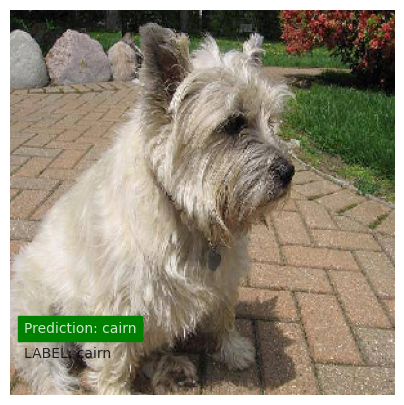

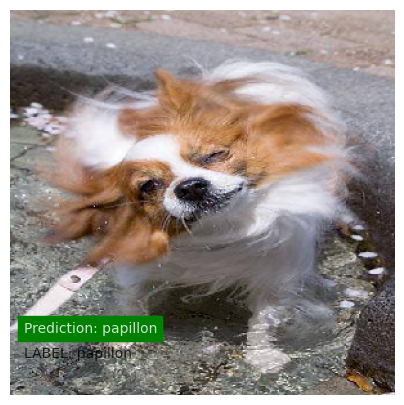

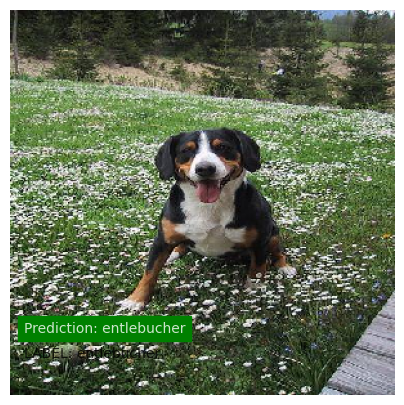

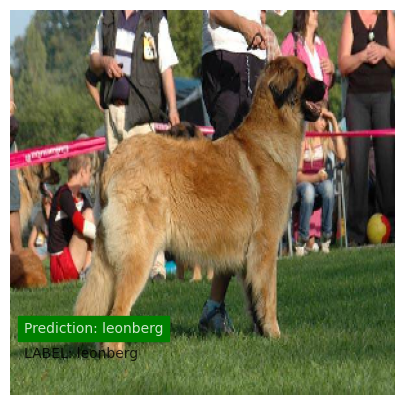

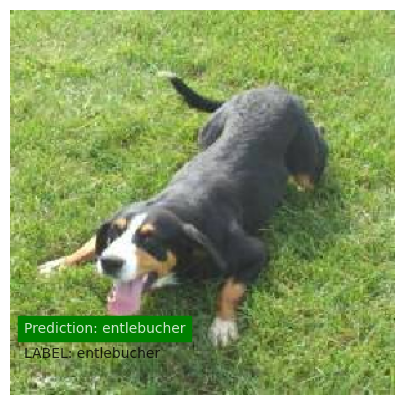

...

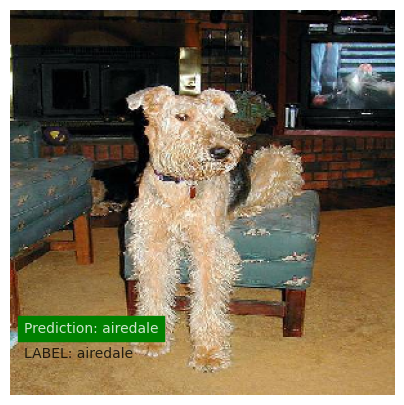

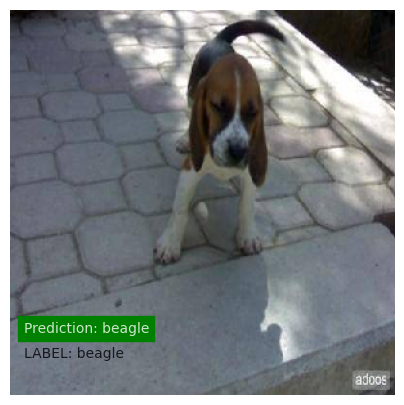

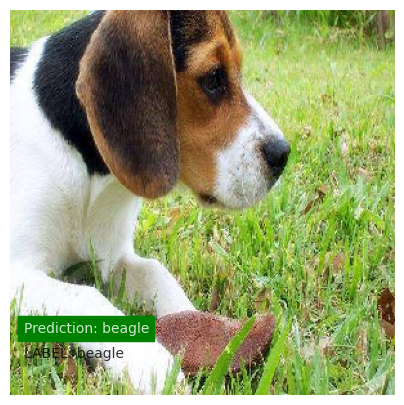

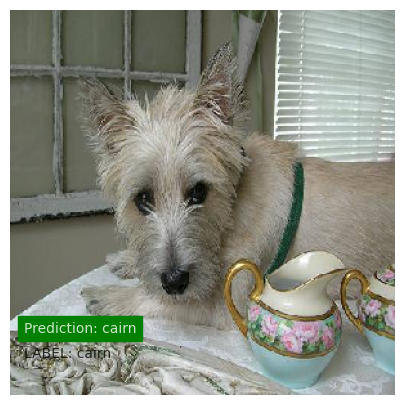

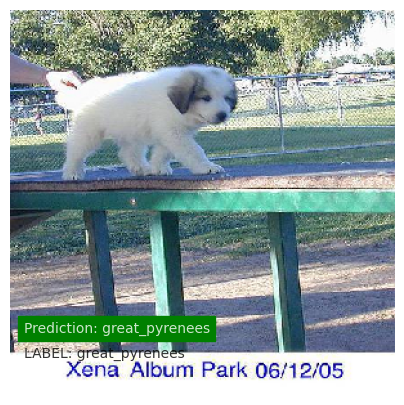

In [ ]:
valid_breeds = (yv * range(NUM_CLASSES)).sum(axis=1)
correct_idx = (valid_breeds == valid_preds)  # Filter for correct predictions
for img_id, breed, pred in zip(labels.loc[valid_idx, 'id'].values[correct_idx],
                               [selected_breed_list[int(b)] for b in valid_preds[correct_idx]],
                               [selected_breed_list[int(b)] for b in valid_breeds[correct_idx]]):
    fix, ax = plt.subplots(figsize=(5,5,))
    img = read_img(img_id, 'train', (299,299))
    ax.imshow(img/255)
    ax.text(10, 250, 'Prediction: %s' % pred, color='w', backgroundcolor='g', alpha=0.8)  # Green background for correct predictions
    ax.text(10, 270, 'LABEL: %s' % breed, color='k', backgroundcolor='none', alpha=0.8)
    ax.axis('off')
    plt.show()


Saving pomerian.jpg to pomerian.jpg
1/1 [==============================] - 1s 1s/step


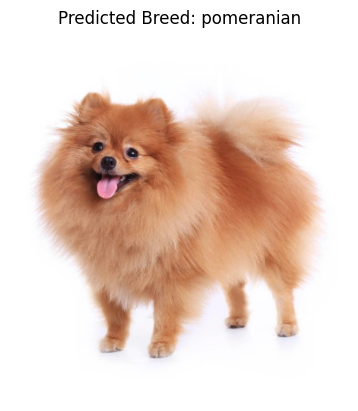

In [ ]:
from google.colab import files

# Upload an image
uploaded = files.upload()

# Process and predict labels for the uploaded image
for filename in uploaded.keys():
    img = image.load_img(filename, target_size=(INPUT_SIZE, INPUT_SIZE))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)

    # Extract bottleneck features
    bottleneck_features = vgg_bottleneck.predict(img)

    # Predict label
    prediction = int(logreg.predict(bottleneck_features)[0])  # Convert prediction to integer
    predicted_breed = selected_breed_list[prediction]

    # Display the uploaded image along with the predicted label
    plt.imshow(image.load_img(filename))
    plt.title(f"Predicted Breed: {predicted_breed}")
    plt.axis('off')
    plt.show()


In [ ]:
import pickle

# Assuming your trained model is named logreg
with open('logreg_model.pkl', 'wb') as f:
    pickle.dump(logreg, f)


In [ ]:
# Load the model back and verify
with open('logreg_model.pkl', 'rb') as f:
    loaded_model = pickle.load(f)

# Now loaded_model should contain your trained logistic regression model


In [ ]:
import pickle
from google.colab import files

# Save the model
with open('logreg_model.pkl', 'wb') as f:
    pickle.dump(logreg, f)

# Download the model
files.download('logreg_model.pkl')


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

Saving irish_wolfhound.jpg to irish_wolfhound.jpg


1/1 [==============================] - 0s 192ms/step


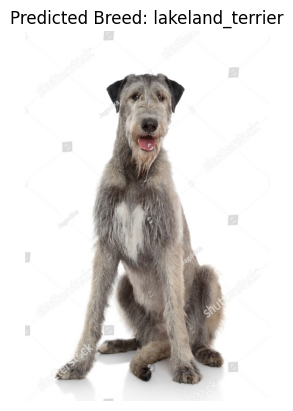

In [ ]:
from google.colab import files
import numpy as np
import matplotlib.pyplot as plt
from keras.preprocessing import image
from keras.applications.vgg16 import preprocess_input
import pickle

# Upload an image
uploaded = files.upload()

# Load the trained logistic regression model
with open('logreg_model.pkl', 'rb') as f:
    logreg = pickle.load(f)

# Preprocess and predict labels for the uploaded image
for filename in uploaded.keys():
    img = image.load_img(filename, target_size=(224, 224))
    img = image.img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = preprocess_input(img)

    # Extract bottleneck features using VGG16
    vgg_bottleneck = VGG16(weights='imagenet', include_top=False, pooling='avg')
    bottleneck_features = vgg_bottleneck.predict(img)

    # Predict label using logistic regression model
    prediction = int(logreg.predict(bottleneck_features)[0])
    predicted_breed = selected_breed_list[prediction]

    # Display the uploaded image along with the predicted label
    plt.imshow(image.load_img(filename))
    plt.title(f"Predicted Breed: {predicted_breed}")
    plt.axis('off')
    plt.show()
